# Niche definition using spatial neighbors  
### Spatial pancreas  

### Pre-requisites

In [1]:
import seaborn as sns
import pandas as pd
import numpy as np

import scanpy as sc
import squidpy as sq

import matplotlib.pyplot as plt

#sc.settings.set_figure_params(dpi=80, facecolor="white")

### Load data

In [2]:
folder = '/lustre/groups/ml01/workspace/sara.jimenez/spatial_pancreas_data/preprocessed_data/data4downstream/'
adata = sc.read(folder+'S1_npod_annotation_filtered.h5ad')
adata

/home/aih/sara.jimenez/miniconda3/envs/spatial/lib/python3.9/site-packages/anndata/__init__.py:51: FutureWarning: `anndata.read` is deprecated, use `anndata.read_h5ad` instead. `ad.read` will be removed in mid 2024.
  warnings.warn(


AnnData object with n_obs × n_vars = 108711 × 979
    obs: 'fov', 'Area', 'AspectRatio', 'CenterX_global_px', 'CenterY_global_px', 'Width', 'Height', 'Mean.MembraneStain', 'Max.MembraneStain', 'Mean.PanCK', 'Max.PanCK', 'Mean.GCG', 'Max.GCG', 'Mean.CD3', 'Max.CD3', 'Mean.DAPI', 'Max.DAPI', 'cell_ID', 'condition', 'slide', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_NegPrb', 'log1p_total_counts_NegPrb', 'pct_counts_NegPrb', 'n_genes', 'cell_type_coarse', 'CellTypes_max'
    uns: 'CellTypes_max_colors', 'cell_type_coarse_colors', 'neighbors', 'pca', 'spatial', 'umap'
    obsm: 'X_pca', 'X_umap', 'spatial', 'spatial_fov'
    layers: 'counts'

In [3]:
adata.obs['CellTypes_max'].cat.categories

Index(['Acinar_basal', 'Acinar_highEnz', 'Acinar_sigdiff', 'Acinar_signal',
       'Activated_Stellate', 'Alpha', 'Beta', 'Delta', 'Ductal', 'Endothelial',
       'MUC5b_Ductal', 'Macrophage', 'Quiescent_Stellate', 'Tcells'],
      dtype='object')

In [4]:
adata.uns['cell_type_coarse_colors'] = [
    '#edd892', #acinar
    '#219ebc', #alpha
    '#adc178', #beta
    '#f79824', #ductal
    '#718355', #endocrine
    '#f15156', #endothelial
    '#bbd0ff', #Fibroblasts
    '#979dac', #Immune
    '#582f0e'  #mast
]

### Data Exploration

In [4]:
adata.obs.fov.cat.categories

Index(['1', '2', '3', '4', '5', '6', '7', '8', '9', '10', '11', '12', '13',
       '14', '15', '16', '17', '18', '19', '20', '21', '22', '23', '24'],
      dtype='object')

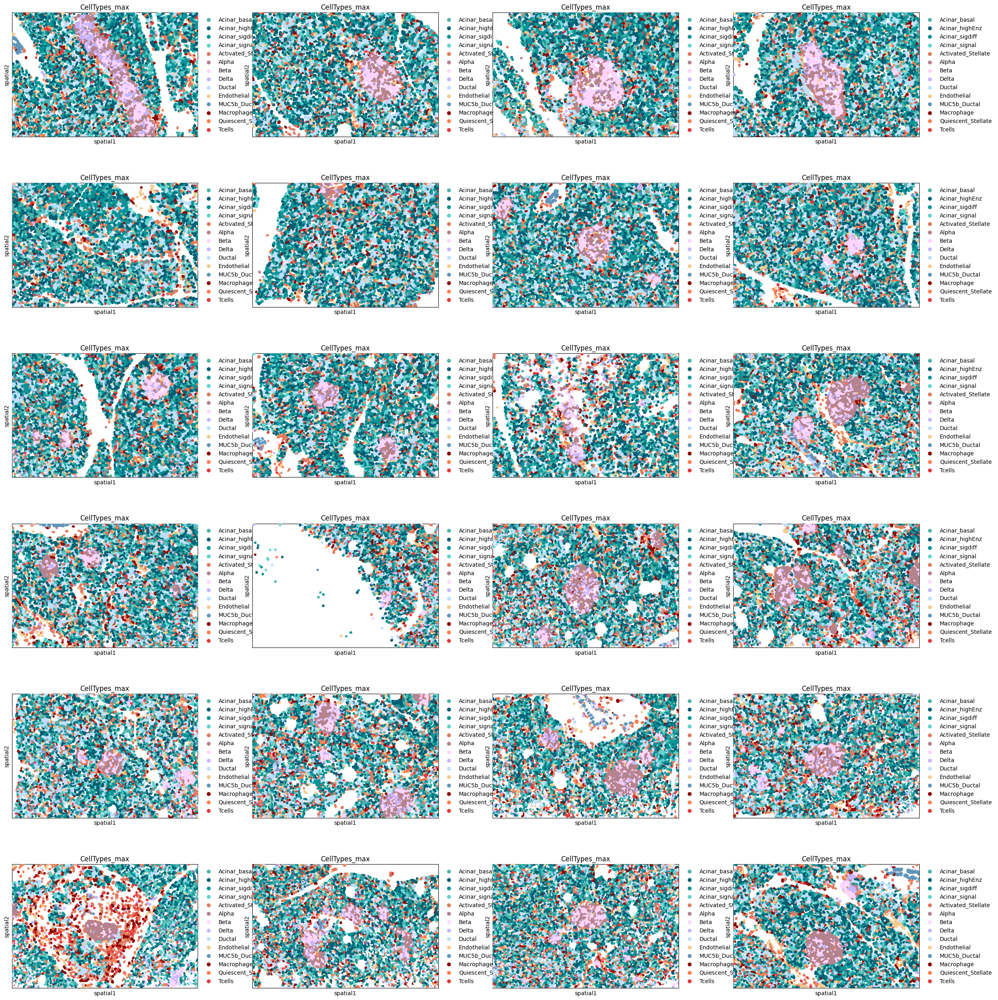

In [5]:
sq.pl.spatial_segment(adata,color='CellTypes_max',ncols=4,#library_id=['10','12'],
                      library_key='fov', seg_cell_id='cell_ID',cmap='RdYlBu_r', img=False)

### Niche definition in terms of nearest neighbors

In [6]:
adata.X.max()

4.715945

In [7]:
adata.layers['counts'].max()

285

In [8]:
# calculating node degree for several distances 
for ng in [5,15,30,50,100,200]:
    connectivities, _ = sq.gr.spatial_neighbors(
        adata, n_neighs=ng, coord_type='generic', copy=True
    )
    print(np.mean(np.sum(connectivities, axis=0)))

5.0
15.0
30.0
50.0
100.0
200.0


In [9]:
sq.gr.spatial_neighbors(
    adata,
    n_neighs=50,
    library_key='fov', # to get the spatial graphs per slide (ie per fov)
    coord_type="generic",
    delaunay=False,
    
)

In [10]:
adata.obsp["spatial_connectivities"].shape

(108711, 108711)

/home/aih/sara.jimenez/miniconda3/envs/spatial/lib/python3.9/site-packages/squidpy/pl/_color_utils.py:28: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  target.uns[color_key] = source.uns[color_key]


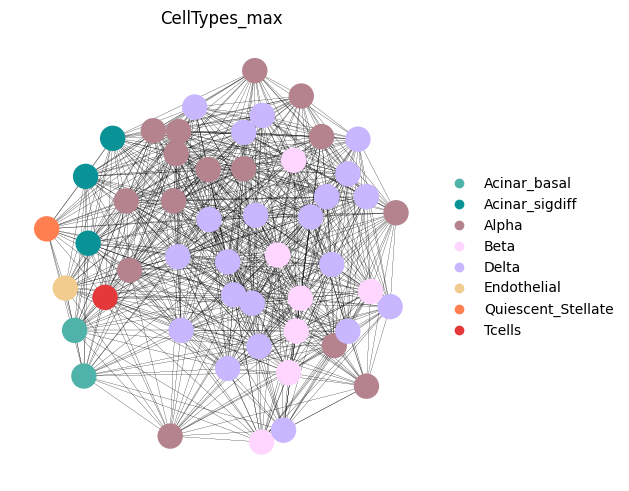

In [12]:
_, idx = adata.obsp["spatial_connectivities"][420, :].nonzero()
idx = np.append(idx, 420)
sq.pl.spatial_scatter(
    adata[idx,420],
    library_id = '12',
    color="CellTypes_max",
    connectivity_key="spatial_connectivities",
    size=30,
    edges_width=.1,
    edges_color="black",
    img=False,
    frameon=False
)

/home/aih/sara.jimenez/miniconda3/envs/spatial/lib/python3.9/site-packages/squidpy/pl/_color_utils.py:28: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  target.uns[color_key] = source.uns[color_key]


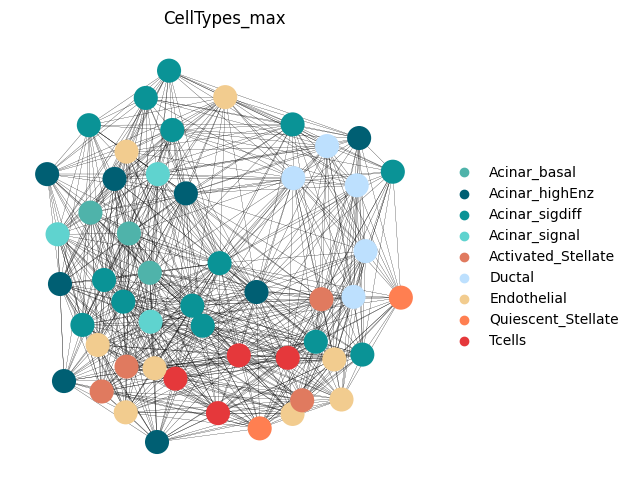

In [13]:
_, idx = adata.obsp["spatial_connectivities"][620, :].nonzero()
idx = np.append(idx, 620)
sq.pl.spatial_scatter(
    adata[idx,620],
    library_id = '10',
    color="CellTypes_max",
    connectivity_key="spatial_connectivities",
    size=30,
    edges_width=.1,
    edges_color="black",
    img=False,
    frameon=False
)

In [14]:
import anndata as ad

In [15]:
# params
library_key = 'fov'
cell_type_key = 'CellTypes_max'
condition_key = 'condition'

In [16]:
niche_datas = []
for f in adata.obs[library_key].unique(): 
    
    fov = adata[np.isin(adata.obs[library_key],[f])].copy()
    
    niche_data = ad.AnnData(X = np.zeros((len(fov.obs_names),len(fov.obs[cell_type_key].unique()))),
                            obs = pd.DataFrame(index=fov.obs_names),
                            var = pd.DataFrame(index=fov.obs[cell_type_key].unique()))

    niche_data.obs['obs_names'] = fov.obs_names
    niche_data.var['var_names'] = fov.obs[cell_type_key].unique()
    niche_data.obs[library_key] = str(f)
    niche_data.obs[condition_key] = fov.obs[condition_key]

    for c in range(len(fov.obs_names)):
        _, idx = fov.obsp["spatial_connectivities"][c, :].nonzero()
        idx = np.append(idx, c)
        cts = fov[idx,].obs[cell_type_key]
        
        for i in cts.unique():
            var_index = niche_data.var_names.get_loc(i)
            niche_data.X[c,var_index] = cts.value_counts()[i]

    niche_datas.append(niche_data)
    del niche_data

In [192]:
niche_data  = ad.concat(niche_datas, join='outer', fill_value=0, axis=0)#, label='fov',keys=adata.obs[library_key].unique())
niche_data

AnnData object with n_obs × n_vars = 108711 × 14
    obs: 'obs_names', 'fov', 'condition'

In [18]:
niche_data.obs_names

Index(['1_1', '2_1', '3_1', '4_1', '5_1', '6_1', '7_1', '8_1', '9_1', '10_1',
       ...
       '4719_24', '4720_24', '4721_24', '4722_24', '4723_24', '4724_24',
       '4725_24', '4726_24', '4727_24', '4728_24'],
      dtype='object', length=108711)

In [19]:
adata.obs_names

Index(['1_1', '2_1', '3_1', '4_1', '5_1', '6_1', '7_1', '8_1', '9_1', '10_1',
       ...
       '4719_24', '4720_24', '4721_24', '4722_24', '4723_24', '4724_24',
       '4725_24', '4726_24', '4727_24', '4728_24'],
      dtype='object', length=108711)

In [20]:
niche_data.obs.condition

1_1        T1D
2_1        T1D
3_1        T1D
4_1        T1D
5_1        T1D
          ... 
4724_24     ND
4725_24     ND
4726_24     ND
4727_24     ND
4728_24     ND
Name: condition, Length: 108711, dtype: category
Categories (2, object): ['ND', 'T1D']

In [193]:
niche_data.obs['cell_type'] = adata.obs['CellTypes_max']

In [194]:
niche_data.uns['cell_type_colors'] = [
    '#4FB3AA',#'Acinar_basal'
    '#005F73',#'Acinar_highEnz', 
    '#0A9396',#'Acinar_sigdiff', 
    '#5FD3CF',#'Acinar_signal',
    '#e07a5f',#'Activated_Stellate', 
    '#b5838d',#'Alpha', 
    #'#f8ad9d',#'Bcells', 
    '#ffd6ff',#'Beta', 
    '#c8b6ff',#'Delta', 
    '#bde0fe',#'Ductal',
    '#f2cc8f',#'Endothelial', 
    #'#ffa62b',#'LymphEndo', 
    '#6096ba',#'MUC5b_Ductal', 
    '#8d0801',#'Macrophage', 
    #'#4f000b',#'Mast',
    '#ff7f51',#'Quiescent_Stellate', 
    #'#ce4257',#'Schwann', 
    '#e5383b',#'Tcells'
]

In [ ]:
niche_data_nd = niche_data[np.isin(niche_data.obs['condition'],['ND'])].copy()
niche_data_nd

In [ ]:
niche_data_nd.obs.fov

In [ ]:
niche_data_t1 = niche_data[np.isin(niche_data.obs['condition'],['T1D'])].copy()
niche_data_t1

In [ ]:
niche_data_t1.obs.fov

### Niche identification samples

/home/aih/sara.jimenez/miniconda3/envs/spatial/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/home/aih/sara.jimenez/miniconda3/envs/spatial/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/aih/sara.jimenez/miniconda3/envs/spatial/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  col

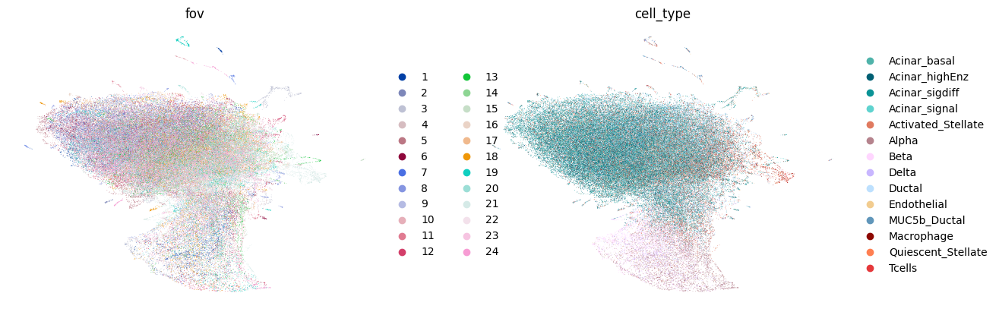

In [195]:
sc.pp.pca(niche_data)
sc.pp.neighbors(niche_data)
sc.tl.umap(niche_data)
sc.pl.umap(niche_data, color=['fov','cell_type'],frameon=False)

In [24]:
niche_data.obs['cell_type'].cat.categories

Index(['Acinar_basal', 'Acinar_highEnz', 'Acinar_sigdiff', 'Acinar_signal',
       'Activated_Stellate', 'Alpha', 'Beta', 'Delta', 'Ductal', 'Endothelial',
       'MUC5b_Ductal', 'Macrophage', 'Quiescent_Stellate', 'Tcells'],
      dtype='object')

/home/aih/sara.jimenez/miniconda3/envs/spatial/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/home/aih/sara.jimenez/miniconda3/envs/spatial/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


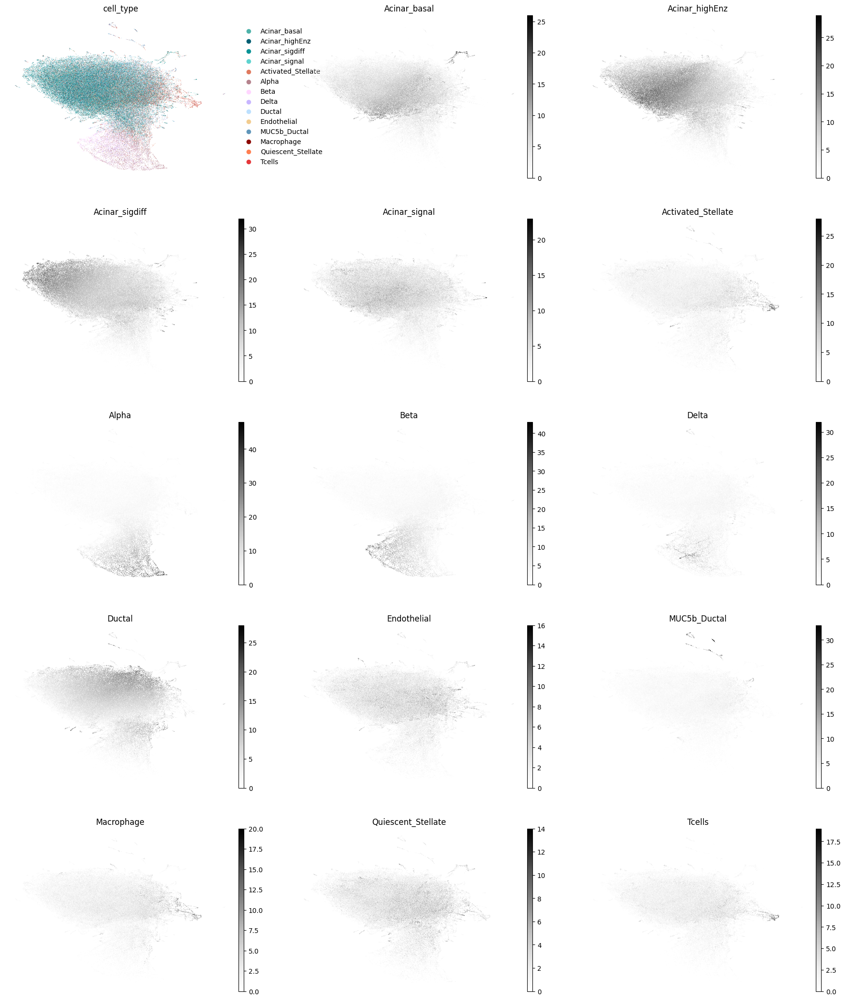

In [26]:
sc.pl.umap(niche_data, color=['cell_type','Acinar_basal', 'Acinar_highEnz', 'Acinar_sigdiff', 'Acinar_signal',
       'Activated_Stellate', 'Alpha', 'Beta', 'Delta', 'Ductal', 'Endothelial',
       'MUC5b_Ductal', 'Macrophage', 'Quiescent_Stellate', 'Tcells'],ncols=3,frameon=False,cmap='Greys')

In [196]:
sc.tl.leiden(niche_data, resolution=0.3, key_added='res_0.1') #, adjacency=fov.obsp["spatial_connectivities"])

/home/aih/sara.jimenez/miniconda3/envs/spatial/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/home/aih/sara.jimenez/miniconda3/envs/spatial/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


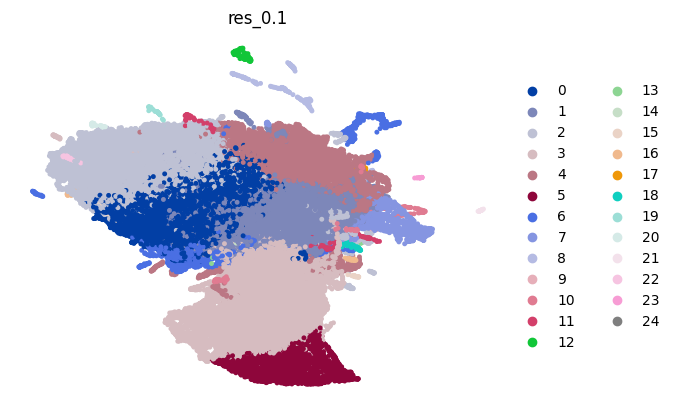

In [197]:
sc.pl.umap(niche_data, color=['res_0.1'],ncols=1,size=50,frameon=False)

/home/aih/sara.jimenez/miniconda3/envs/spatial/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/home/aih/sara.jimenez/miniconda3/envs/spatial/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


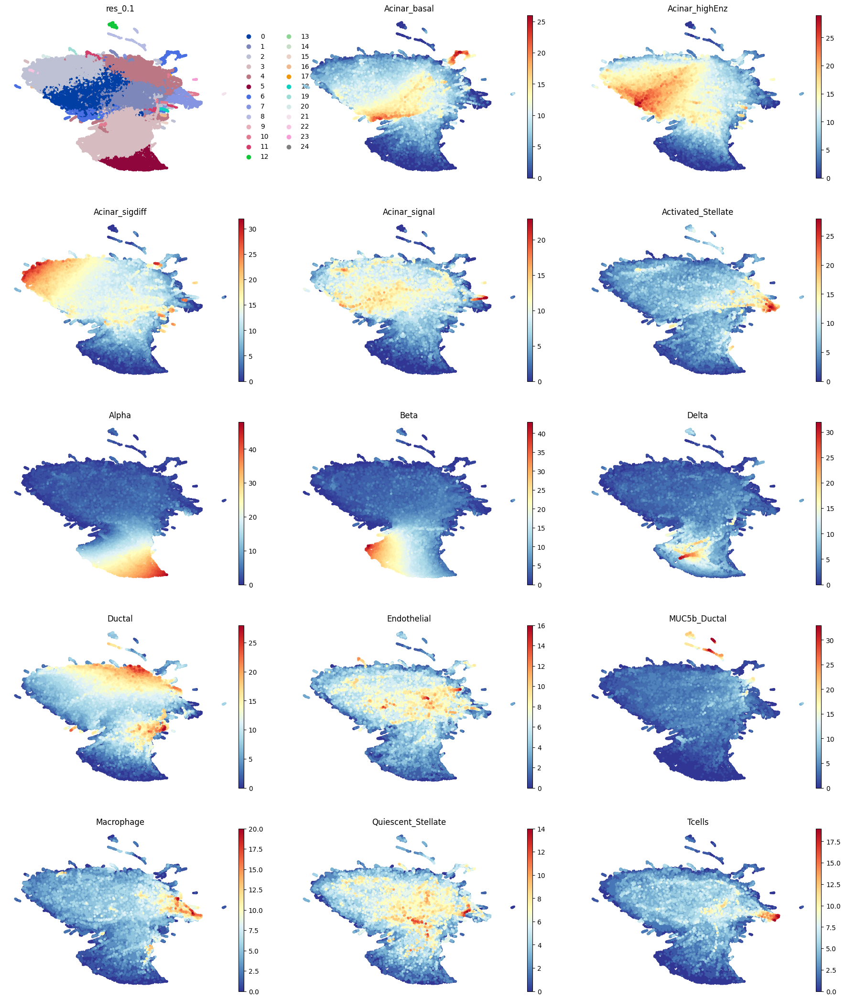

In [54]:
sc.pl.umap(niche_data, color=['res_0.1','Acinar_basal', 'Acinar_highEnz', 'Acinar_sigdiff', 'Acinar_signal',
       'Activated_Stellate', 'Alpha', 'Beta', 'Delta', 'Ductal', 'Endothelial',
       'MUC5b_Ductal', 'Macrophage', 'Quiescent_Stellate', 'Tcells'],ncols=3, size=50,frameon=False,cmap='RdYlBu_r')

/home/aih/sara.jimenez/miniconda3/envs/spatial/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/home/aih/sara.jimenez/miniconda3/envs/spatial/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


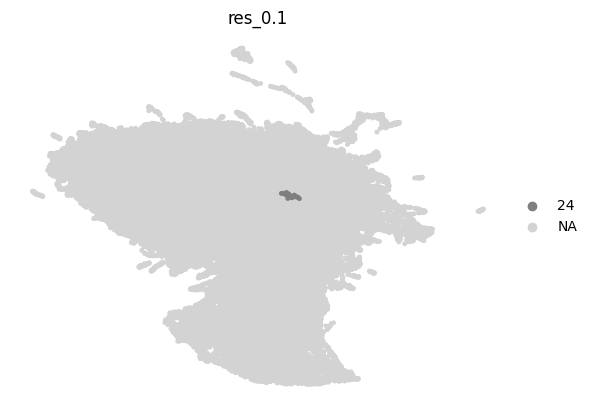

In [69]:
sc.pl.umap(niche_data, color=['res_0.1'], groups=['24'],ncols=5, size=50,frameon=False)

In [36]:
niche_data.obs['res_0.1'].cat.categories

Index(['0', '1', '2', '3', '4', '5', '6', '7', '8', '9', '10', '11', '12',
       '13', '14', '15', '16', '17', '18', '19', '20', '21', '22', '23', '24'],
      dtype='object')

In [198]:
niche2annotation = {
    '0' : 'Niche_1',#'Acinar_highEnz',
    '1' : 'Niche_2',#'Acinar_basal',
    '2' : 'Niche_3',#'Acinar_sigdiff',    
    '3' : 'Niche_5',#'Beta',
    '4' : 'Niche_7',#'Ductal',
    '5' : 'Niche_6',#'Alpha',
    '6' : 'Niche_2',#'Acinar_basal',
    '7' : 'Niche_9',#'Immune_cells',
    '8' : 'Niche_8',#'MUC5b_Ductal',
    '9' : 'Niche_2',#'Acinar_basal',
    '10' : 'Niche_9',#'Immune', 
    '11' : 'Niche_10',#'Endothelial',
    '12' : 'Niche_8',#'MUC5b_Ductal',
    '13' : 'Niche_10',#'Endothelial',
    '14' : 'Niche_10',#'Endothelial',
    '15' : 'Niche_3',#'Acinar_sigdiff',
    '16' : 'Niche_1',#'Acinar_highEnz',
    '17' : 'Niche_10',#'Endothelial',
    '18' : 'Niche_7',#'Ductal',
    '19' : 'Niche_10',#'Endothelial',
    '20' : 'Niche_4',#'Acinar_signal',
    '21' : 'Niche_7',#'Ductal',
    '22' : 'Niche_3',#'Acinar_sigdiff',
    '23' : 'Niche_4',#'Acinar_signal',
    '24' : 'Niche_10',#'Endothelial'
}

niche_data.obs['niche_label'] = niche_data.obs['res_0.1'].map(niche2annotation).astype('category')

niche_data.obs['niche_label'].cat.reorder_categories(['Niche_1','Niche_2','Niche_3','Niche_4','Niche_5',
                                                        'Niche_6','Niche_7','Niche_8','Niche_9','Niche_10'])

1_1        Niche_1
2_1        Niche_1
3_1        Niche_1
4_1        Niche_1
5_1        Niche_1
            ...   
4724_24    Niche_2
4725_24    Niche_2
4726_24    Niche_1
4727_24    Niche_2
4728_24    Niche_3
Name: niche_label, Length: 108711, dtype: category
Categories (10, object): ['Niche_1', 'Niche_2', 'Niche_3', 'Niche_4', ..., 'Niche_7', 'Niche_8', 'Niche_9', 'Niche_10']

In [232]:
sc.pp.log1p(niche_data)

In [233]:
sc.tl.rank_genes_groups(niche_data, 'niche_label', method='t-test',pts=True)

In [107]:
sc.tl.rank_genes_groups(niche_data, 'condition',key_added='rank_genes_groups_condition', method='t-test',pts=True)

In [82]:
niche_data

AnnData object with n_obs × n_vars = 108711 × 14
    obs: 'obs_names', 'fov', 'condition', 'cell_type', 'res_0.3', 'res_0.1', 'niche_label'
    uns: 'cell_type_colors', 'pca', 'neighbors', 'umap', 'fov_colors', 'leiden', 'res_0.3_colors', 'res_0.1_colors', 'rank_genes_groups', 'dendrogram_niche_label'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'distances', 'connectivities'

/home/aih/sara.jimenez/miniconda3/envs/spatial/lib/python3.9/site-packages/scanpy/tools/_dendrogram.py:135: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_df = rep_df.groupby(level=0).mean()
/home/aih/sara.jimenez/miniconda3/envs/spatial/lib/python3.9/site-packages/scanpy/get/get.py:69: FutureWarning: The previous implementation of stack is deprecated and will be removed in a future version of pandas. See the What's New notes for pandas 2.1.0 for details. Specify future_stack=True to adopt the new implementation and silence this warning.
  d = d.stack(level=1).reset_index()
/home/aih/sara.jimenez/miniconda3/envs/spatial/lib/python3.9/site-packages/scanpy/get/get.py:69: FutureWarning: The previous implementation of stack is deprecated and will be removed in a future version of pandas. See the W

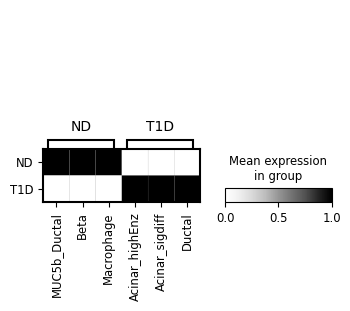

In [114]:
sc.tl.dendrogram(niche_data, groupby='niche_label')
sc.pl.rank_genes_groups_matrixplot(
    niche_data,
    n_genes=3, groupby='condition',key='rank_genes_groups_condition',
    #values_to_plot="logfoldchanges",
    cmap='Greys',standard_scale='var'
)

/home/aih/sara.jimenez/miniconda3/envs/spatial/lib/python3.9/site-packages/scanpy/get/get.py:69: FutureWarning: The previous implementation of stack is deprecated and will be removed in a future version of pandas. See the What's New notes for pandas 2.1.0 for details. Specify future_stack=True to adopt the new implementation and silence this warning.
  d = d.stack(level=1).reset_index()
/home/aih/sara.jimenez/miniconda3/envs/spatial/lib/python3.9/site-packages/scanpy/get/get.py:69: FutureWarning: The previous implementation of stack is deprecated and will be removed in a future version of pandas. See the What's New notes for pandas 2.1.0 for details. Specify future_stack=True to adopt the new implementation and silence this warning.
  d = d.stack(level=1).reset_index()
/home/aih/sara.jimenez/miniconda3/envs/spatial/lib/python3.9/site-packages/scanpy/get/get.py:69: FutureWarning: The previous implementation of stack is deprecated and will be removed in a future version of pandas. See th

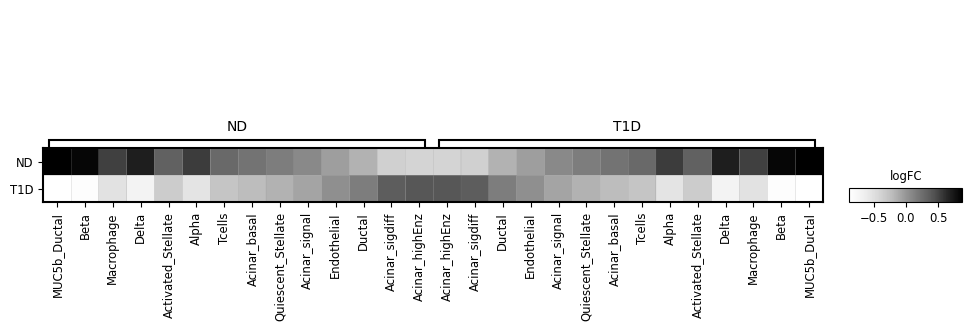

In [129]:
sc.pl.rank_genes_groups_matrixplot(
    niche_data,
    n_genes=14, key='rank_genes_groups_condition',
    values_to_plot="logfoldchanges",
    cmap='Greys',#standard_scale='var',
    groupby='condition',colorbar_title='logFC',
)

/home/aih/sara.jimenez/miniconda3/envs/spatial/lib/python3.9/site-packages/scanpy/get/get.py:69: FutureWarning: The previous implementation of stack is deprecated and will be removed in a future version of pandas. See the What's New notes for pandas 2.1.0 for details. Specify future_stack=True to adopt the new implementation and silence this warning.
  d = d.stack(level=1).reset_index()
/home/aih/sara.jimenez/miniconda3/envs/spatial/lib/python3.9/site-packages/scanpy/get/get.py:69: FutureWarning: The previous implementation of stack is deprecated and will be removed in a future version of pandas. See the What's New notes for pandas 2.1.0 for details. Specify future_stack=True to adopt the new implementation and silence this warning.
  d = d.stack(level=1).reset_index()
/home/aih/sara.jimenez/miniconda3/envs/spatial/lib/python3.9/site-packages/scanpy/get/get.py:69: FutureWarning: The previous implementation of stack is deprecated and will be removed in a future version of pandas. See th

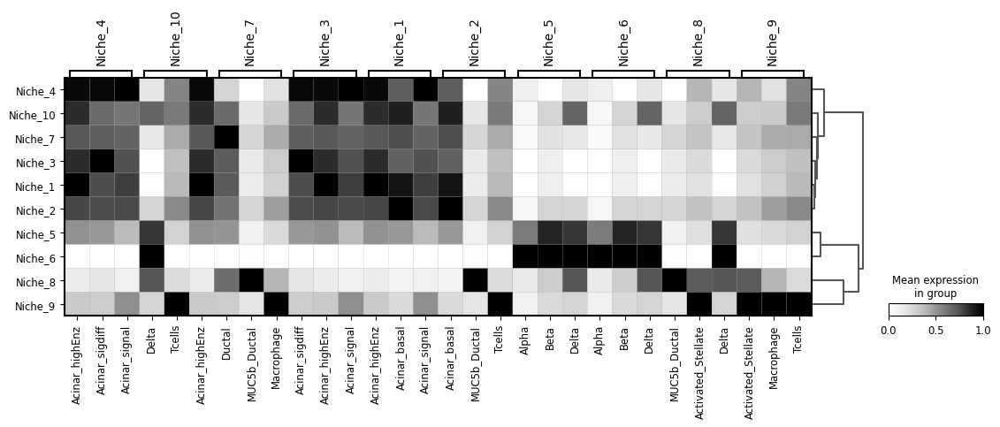

In [238]:
sc.pl.rank_genes_groups_matrixplot(
    niche_data,
    n_genes=3, key='rank_genes_groups',
    #values_to_plot="logfoldchanges",#'logfoldchanges',#"pvals_adj",
    cmap='Greys',standard_scale='var',
    groupby='niche_label',
)

In [199]:
niche_data_test = niche_data.copy()
niche_data_test.X

array([[ 4., 19., 15., ...,  0.,  2.,  1.],
       [ 8., 17., 15., ...,  0.,  1.,  2.],
       [ 7., 11., 11., ...,  0.,  0.,  3.],
       ...,
       [ 1., 15., 13., ...,  1.,  1.,  1.],
       [10.,  8.,  8., ...,  0.,  1.,  1.],
       [ 9.,  9., 16., ...,  0.,  1.,  0.]])

In [200]:
niche_data_test.obs.niche_label.value_counts()

niche_label
Niche_1     28060
Niche_2     27860
Niche_3     22288
Niche_5     14585
Niche_7     11734
Niche_6      2301
Niche_9      1029
Niche_10      458
Niche_8       343
Niche_4        53
Name: count, dtype: int64

/tmp/ipykernel_2170840/2516799318.py:7: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped = df.groupby('niche_label')[df.columns[df.dtypes != 'category']].sum()


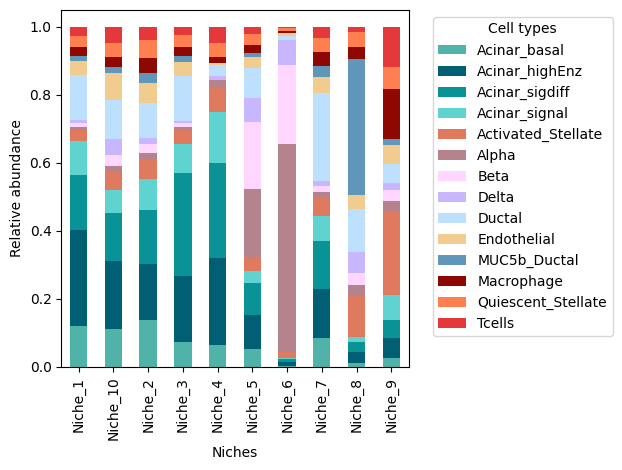

In [218]:
# Combine obs and X data for easier manipulation
df = pd.concat([niche_data_test.obs, 
               pd.DataFrame(niche_data_test.X, index=niche_data_test.obs.index, columns=niche_data_test.var_names)], axis=1)

# Group by the categorical column in obs and sum the counts for each var_name
# Ensure that we only select numeric columns for the summation
grouped = df.groupby('niche_label')[df.columns[df.dtypes != 'category']].sum()
grouped = grouped.drop(columns=['obs_names'])
normalized_counts = grouped.div(grouped.sum(axis=1), axis=0)

#colors 
colors = ['#4FB3AA',#'Acinar_basal'
          '#005F73',#'Acinar_highEnz', 
          '#0A9396',#'Acinar_sigdiff', 
          '#5FD3CF',#'Acinar_signal',
          '#e07a5f',#'Activated_Stellate', 
          '#b5838d',#'Alpha', 
          #'#f8ad9d',#'Bcells', 
          '#ffd6ff',#'Beta', 
          '#c8b6ff',#'Delta', 
          '#bde0fe',#'Ductal',
          '#f2cc8f',#'Endothelial', 
          #'#ffa62b',#'LymphEndo', 
          '#6096ba',#'MUC5b_Ductal', 
          '#8d0801',#'Macrophage', 
          #'#4f000b',#'Mast',
          '#ff7f51',#'Quiescent_Stellate', 
          #'#ce4257',#'Schwann', 
          '#e5383b',#'Tcells'
]

# Plot a stacked bar chart
ax = normalized_counts.plot(kind='bar', stacked=True,color=colors)

# Customize the plot (labels, title, etc.)
plt.xlabel('Niches')
plt.ylabel('Relative abundance')
#plt.title('Stacked Bar Plot of Counts per Category')
plt.xticks(rotation=90)
# Step 3: Position the legend outside the plot
plt.legend(title='Cell types', bbox_to_anchor=(1.05, 1), loc='upper left')

# Adjust layout to make room for the legend
plt.tight_layout()


# Show the plot
plt.show()

/tmp/ipykernel_2170840/4228401539.py:7: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped = df.groupby('condition')[df.columns[df.dtypes != 'category']].sum()


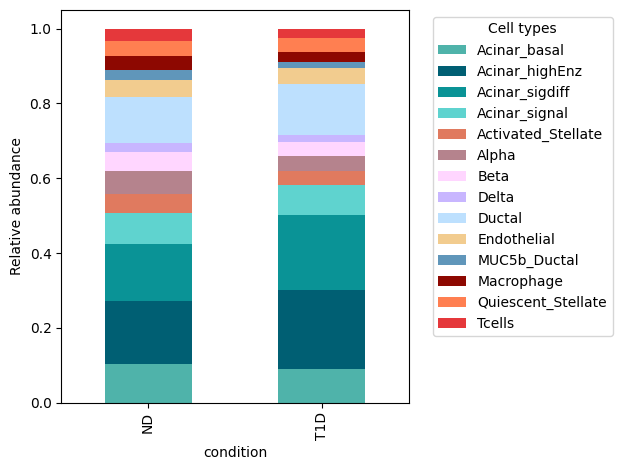

In [219]:
# Combine obs and X data for easier manipulation
df = pd.concat([niche_data_test.obs, 
               pd.DataFrame(niche_data_test.X, index=niche_data_test.obs.index, columns=niche_data_test.var_names)], axis=1)

# Group by the categorical column in obs and sum the counts for each var_name
# Ensure that we only select numeric columns for the summation
grouped = df.groupby('condition')[df.columns[df.dtypes != 'category']].sum()
grouped = grouped.drop(columns=['obs_names'])
normalized_counts = grouped.div(grouped.sum(axis=1), axis=0)

#colors 
colors = ['#4FB3AA',#'Acinar_basal'
          '#005F73',#'Acinar_highEnz', 
          '#0A9396',#'Acinar_sigdiff', 
          '#5FD3CF',#'Acinar_signal',
          '#e07a5f',#'Activated_Stellate', 
          '#b5838d',#'Alpha', 
          #'#f8ad9d',#'Bcells', 
          '#ffd6ff',#'Beta', 
          '#c8b6ff',#'Delta', 
          '#bde0fe',#'Ductal',
          '#f2cc8f',#'Endothelial', 
          #'#ffa62b',#'LymphEndo', 
          '#6096ba',#'MUC5b_Ductal', 
          '#8d0801',#'Macrophage', 
          #'#4f000b',#'Mast',
          '#ff7f51',#'Quiescent_Stellate', 
          #'#ce4257',#'Schwann', 
          '#e5383b',#'Tcells'
]

# Plot a stacked bar chart
ax = normalized_counts.plot(kind='bar', stacked=True,color=colors)

# Customize the plot (labels, title, etc.)
plt.xlabel('condition')
plt.ylabel('Relative abundance')
#plt.title('Stacked Bar Plot of Counts per Category')
plt.xticks(rotation=90)
# Step 3: Position the legend outside the plot
plt.legend(title='Cell types', bbox_to_anchor=(1.05, 1), loc='upper left')

# Adjust layout to make room for the legend
plt.tight_layout()


# Show the plot
plt.show()

/tmp/ipykernel_2170840/506265602.py:2: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped = niche_data_test.obs.groupby(['niche_label', 'condition']).size().unstack(fill_value=0)


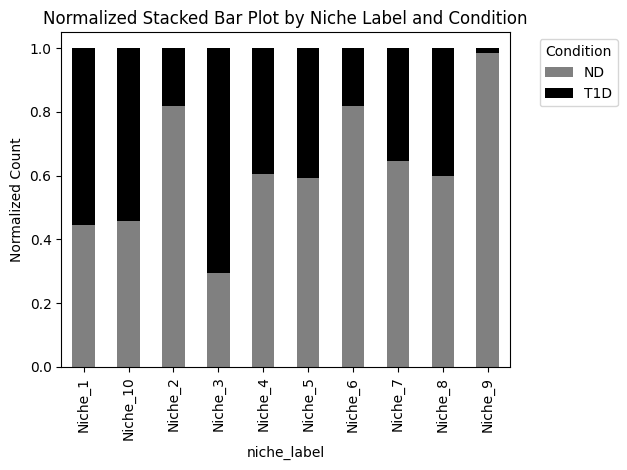

In [224]:
# Step 1: Group by 'niche_label' and 'condition' and count the number of cells
grouped = niche_data_test.obs.groupby(['niche_label', 'condition']).size().unstack(fill_value=0)

# Step 2: Normalize the counts within each 'niche_label'
normalized_counts = grouped.div(grouped.sum(axis=1), axis=0)

# Define colors for the 'condition' categories
colors = ['#808080', '#000000']  

# Step 3: Create a normalized stacked bar plot
ax = normalized_counts.plot(kind='bar', stacked=True, color=colors)

# Add labels and title
plt.ylabel('Normalized Count')
plt.xticks(rotation=90)
plt.legend(title='Condition', bbox_to_anchor=(1.05, 1), loc='upper left')

# Adjust layout to make room for the legend
plt.tight_layout()

# Show the plot
plt.show()

/tmp/ipykernel_2170840/51412730.py:2: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped = niche_data_test.obs.groupby(['condition', 'niche_label']).size().unstack(fill_value=0)


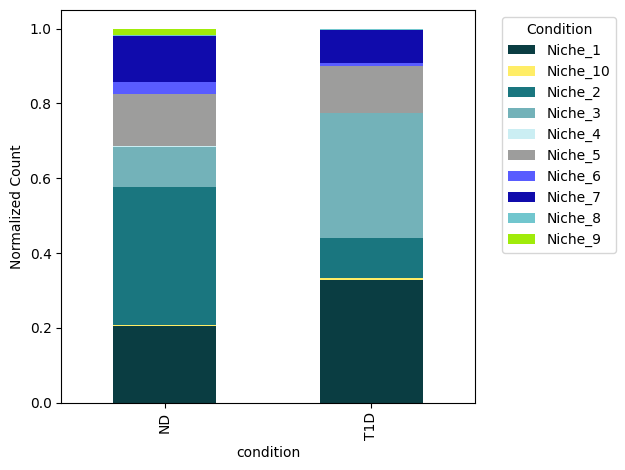

In [226]:
# Step 1: Group by 'niche_label' and 'condition' and count the number of cells
grouped = niche_data_test.obs.groupby(['condition', 'niche_label']).size().unstack(fill_value=0)

# Step 2: Normalize the counts within each 'niche_label'
normalized_counts = grouped.div(grouped.sum(axis=1), axis=0)

# Define colors for the 'niche_label' categories
colors = ['#0A3D42',#N1
          '#FFED66',#N10
          '#1a767f',#N2
          '#73B2B9',#N3
          '#CBEEF3',#N4
          '#9D9D9C',#N5
          '#595CFF',#N6
          '#100BAC',#N7
          '#71C6CE',#N8
          '#A0EB0A',#N9    
         ]  

# Step 3: Create a normalized stacked bar plot
ax = normalized_counts.plot(kind='bar', stacked=True, color=colors)

# Add labels and title
plt.ylabel('Normalized Count')
plt.xticks(rotation=90)
plt.legend(title='Condition', bbox_to_anchor=(1.05, 1), loc='upper left')

# Adjust layout to make room for the legend
plt.tight_layout()

# Show the plot
plt.show()

### Transfer Niche labels to anndata

In [77]:
adata.obs['niche_label'] = niche_data.obs['niche_label']

In [78]:
adata.obs['niche_label'].cat.categories

Index(['Niche_1', 'Niche_10', 'Niche_2', 'Niche_3', 'Niche_4', 'Niche_5',
       'Niche_6', 'Niche_7', 'Niche_8', 'Niche_9'],
      dtype='object')

In [138]:
adata.uns['niche_label_colors'] = [
    '#0A3D42',
    '#1a767f',
    '#73B2B9',
    '#CBEEF3',
    '#9D9D9C',
    '#595CFF',
    '#100BAC',
    '#71C6CE',
    '#A0EB0A',
    '#FFED66'
]

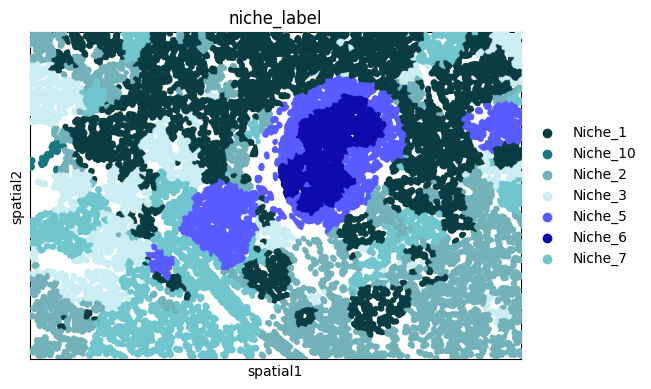

In [139]:
sq.pl.spatial_segment(
    adata,
    library_id="12",
    seg_cell_id="cell_ID",
    library_key="fov",
    color=['niche_label'],
    size=60,
    img=False,cmap="RdYlBu_r",ncols=1
)

In [140]:
adata.obs

,fov,Area,AspectRatio,CenterX_global_px,CenterY_global_px,Width,Height,Mean.MembraneStain,Max.MembraneStain,Mean.PanCK,...,pct_counts_in_top_100_genes,pct_counts_in_top_200_genes,pct_counts_in_top_500_genes,total_counts_NegPrb,log1p_total_counts_NegPrb,pct_counts_NegPrb,n_genes,cell_type_coarse,CellTypes_max,niche_label
1_1,1,3038,2.05,-25945.777778,122127.000000,88,43,1830,13181,74,...,100.000000,100.0,100.0,1,0.693147,0.418410,97,Acinar,Acinar_signal,Niche_1
2_1,1,2507,1.34,-25566.777778,122125.000000,63,47,902,5621,82,...,100.000000,100.0,100.0,1,0.693147,0.581395,73,Acinar,Acinar_basal,Niche_1
3_1,1,7970,1.53,-25278.777778,122102.000000,142,93,1476,7846,134,...,82.862191,100.0,100.0,3,1.386294,0.530035,197,Acinar,Endothelial,Niche_1
4_1,1,5041,1.80,-24148.777778,122116.000000,115,64,931,7451,161,...,87.500000,100.0,100.0,2,1.098612,0.595238,142,Acinar,Acinar_highEnz,Niche_1
5_1,1,3835,1.17,-24070.777778,122108.000000,95,81,1016,7478,152,...,88.073394,100.0,100.0,0,0.000000,0.000000,139,Acinar,Acinar_highEnz,Niche_1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4724_24,24,1666,1.02,26190.222222,139474.888889,48,47,431,1514,95,...,100.000000,100.0,100.0,0,0.000000,0.000000,22,Fibroblasts,Acinar_sigdiff,Niche_2
4725_24,24,2624,1.35,29172.222222,139465.888889,69,51,688,7950,77,...,100.000000,100.0,100.0,0,0.000000,0.000000,16,Acinar,Delta,Niche_2
4726_24,24,2473,1.04,27394.222222,139466.888889,56,54,408,2139,156,...,100.000000,100.0,100.0,0,0.000000,0.000000,52,Acinar,Acinar_signal,Niche_1
4727_24,24,1821,1.33,24815.222222,139460.888889,56,42,223,1113,77,...,100.000000,100.0,100.0,0,0.000000,0.000000,11,Acinar,Acinar_basal,Niche_2


In [142]:
sq.tl.var_by_distance(
    adata=adata,
    groups="Niche_5",
    cluster_key="niche_label",
    library_key="fov",
    covariates=["condition"]
)

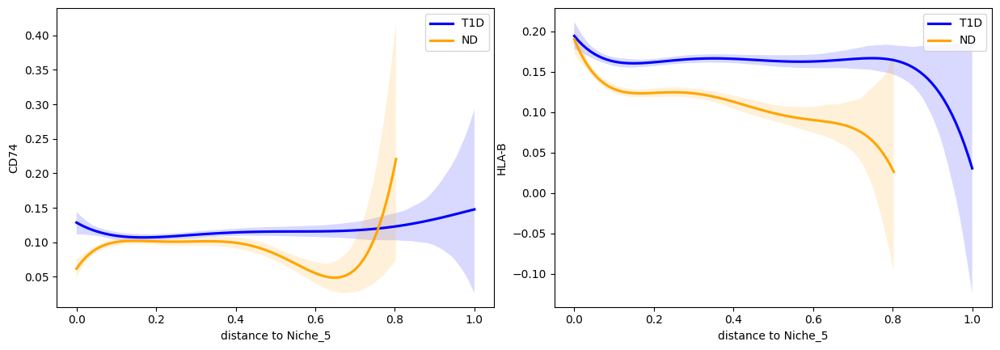

In [176]:
sq.pl.var_by_distance(
    adata=adata,
    design_matrix_key="design_matrix",
    var=["CD74",'HLA-B'],
    anchor_key="Niche_5",
    covariate="condition",
    line_palette=["blue", "orange"],
    show_scatter=False,
    figsize=(5, 4),
)

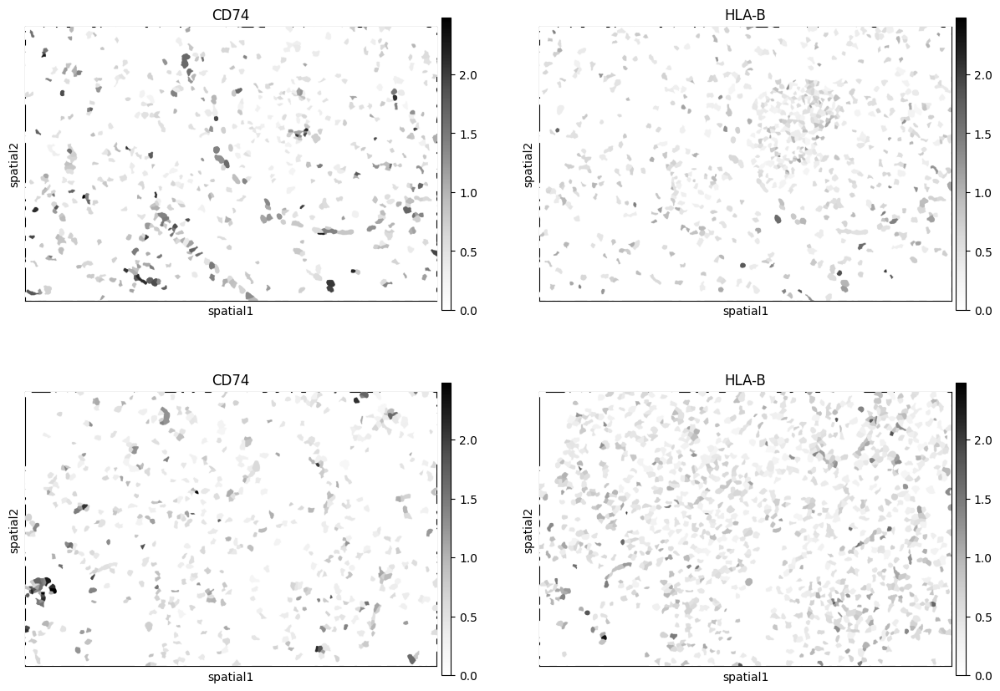

In [177]:
sq.pl.spatial_segment(
    adata,
    library_id=['12','10'],
    seg_cell_id="cell_ID",
    library_key="fov",
    color=["CD74",'HLA-B'],
    size=60,
    img=False,cmap="Greys",ncols=2
)

In [229]:
adata.obs.fov.cat.categories

Index(['1', '2', '3', '4', '5', '6', '7', '8', '9', '10', '11', '12', '13',
       '14', '15', '16', '17', '18', '19', '20', '21', '22', '23', '24'],
      dtype='object')

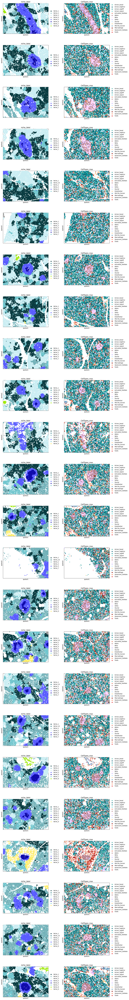

In [227]:
sq.pl.spatial_segment(
    adata,
    #library_id="12",
    seg_cell_id="cell_ID",
    library_key="fov",
    color=['niche_label','CellTypes_max'],
    size=60,
    img=False,cmap="RdYlBu_r",ncols=2
)

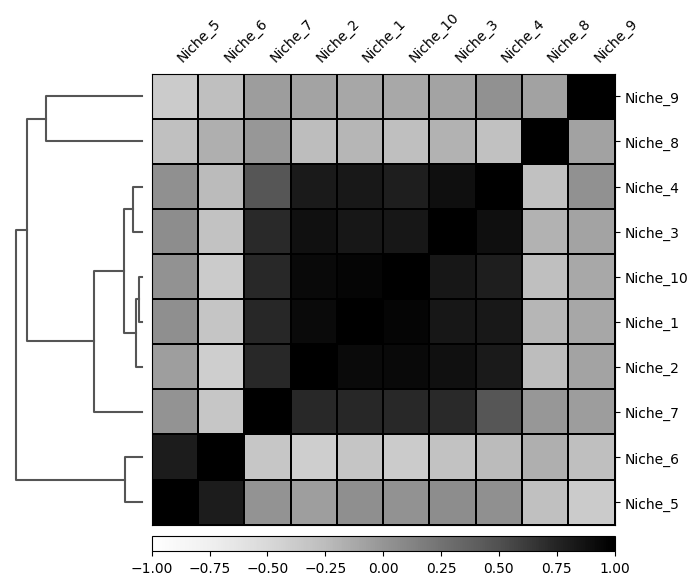

In [81]:
sc.pl.correlation_matrix(niche_data, "niche_label", cmap='Greys')

In [230]:
adata.write('/lustre/groups/ml01/workspace/sara.jimenez/spatial_pancreas_data/preprocessed_data/data4downstream/S1_ct_based_niche_label_npod_annotated.h5ad')

In [73]:
import anndata as ad
test  = ad.concat([adata_t1,adata_nd], join='inner',uns_merge='same',axis=0)
test.write('/lustre/groups/ml01/workspace/sara.jimenez/spatial_pancreas_data/preprocessed_data/data4downstream/S1_niche_label_annotated.h5ad')

In [75]:
test

AnnData object with n_obs × n_vars = 104816 × 979
    obs: 'fov', 'Area', 'AspectRatio', 'CenterX_global_px', 'CenterY_global_px', 'Width', 'Height', 'Mean.MembraneStain', 'Max.MembraneStain', 'Mean.PanCK', 'Max.PanCK', 'Mean.GCG', 'Max.GCG', 'Mean.CD3', 'Max.CD3', 'Mean.DAPI', 'Max.DAPI', 'cell_ID', 'condition', 'slide', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_NegPrb', 'log1p_total_counts_NegPrb', 'pct_counts_NegPrb', 'n_genes', 'cell_type_coarse', 'niche_label'
    uns: 'spatial', 'cell_type_coarse_colors', 'spatial_neighbors'
    obsm: 'spatial', 'spatial_fov'
    layers: 'counts'

In [77]:
sq.gr.spatial_neighbors(
    test,
    n_neighs=50,
    coord_type="generic",
    delaunay=True,
    library_key='fov'
)

/home/aih/sara.jimenez/miniconda3/envs/spatial/lib/python3.9/site-packages/squidpy/pl/_color_utils.py:28: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  target.uns[color_key] = source.uns[color_key]


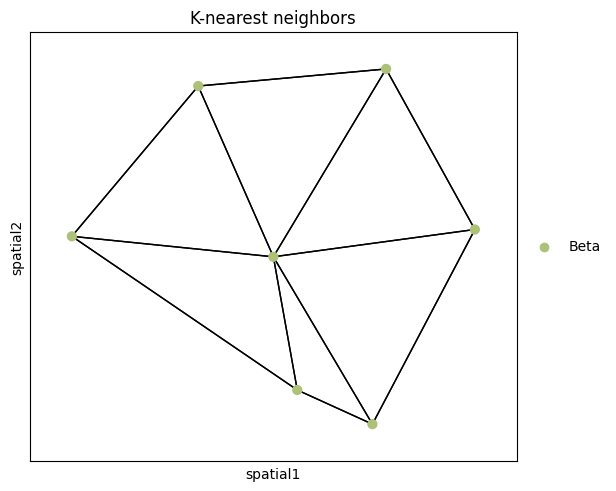

In [78]:
_, idx = test.obsp["spatial_connectivities"][420, :].nonzero()
idx = np.append(idx, 420)
sq.pl.spatial_scatter(
    test[idx,420],
    library_id = '12',
    color="cell_type_coarse",
    connectivity_key="spatial_connectivities",
    size=3,
    edges_width=1,
    edges_color="black",
    img=False,
    title="K-nearest neighbors"
)

In [79]:
sq.gr.nhood_enrichment(test,cluster_key='cell_type_coarse')

100%|██████████| 1000/1000 [00:08<00:00, 122.36/s]


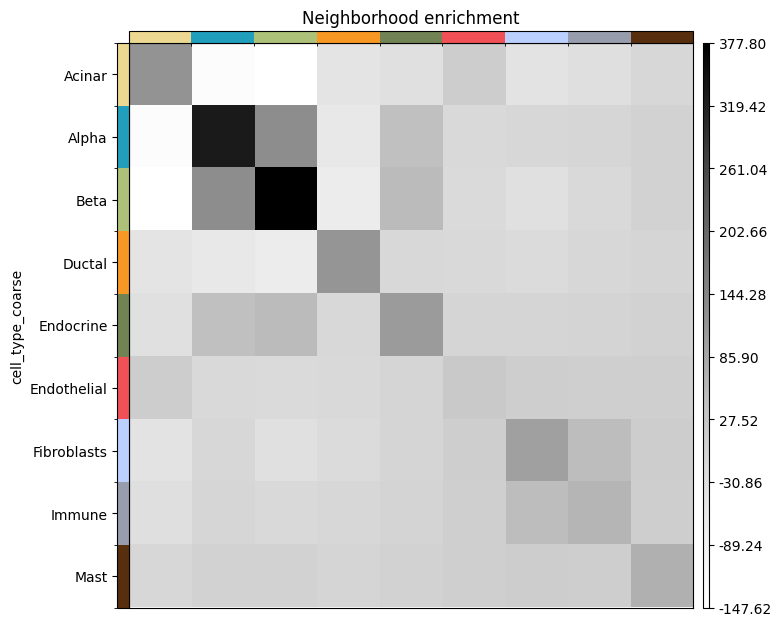

In [80]:
sq.pl.nhood_enrichment(test, cluster_key='cell_type_coarse',cmap='Greys')

In [81]:
sq.gr.centrality_scores(test, cluster_key="cell_type_coarse")

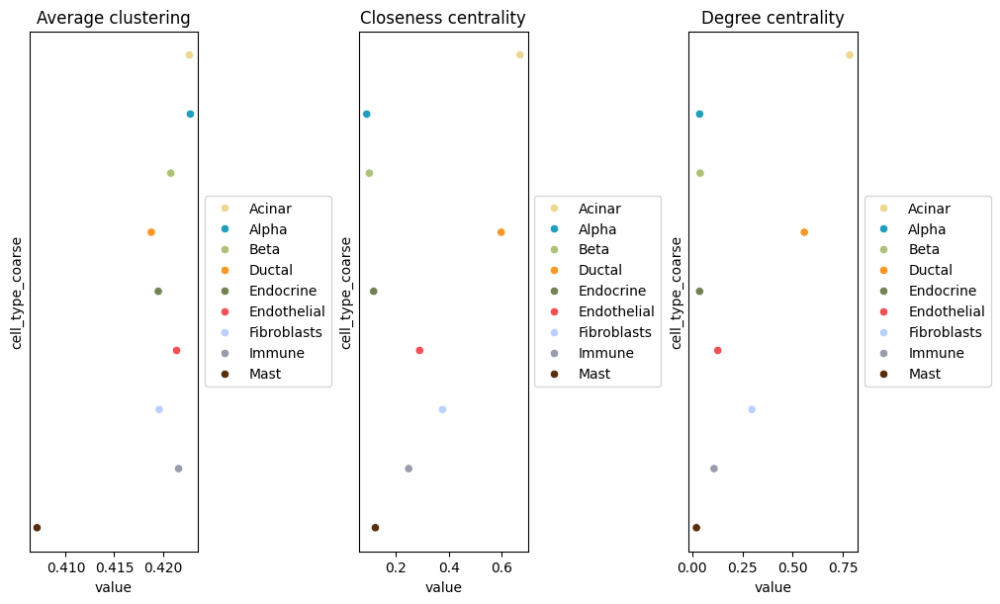

In [82]:
sq.pl.centrality_scores(test, cluster_key="cell_type_coarse", figsize=(10, 6))